# Imports

In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import missingno as msno
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')
import warnings
warnings.filterwarnings('ignore') 
%matplotlib inline

In [2]:
df = pd.read_csv('Cab_Dataset_2.0.csv')

In [3]:
df.head(5)

,Cab_Type,Cab_Price,Arrival_Time,Pick_Up,Destination,Current Time,Current Day
0,UberGoPerson1,₹280.96,2 mins away•21:16 drop-off,Elante Mall,Plaksha University,"09/09/2023, 20:39:04",Saturday
1,UberXLPerson1,₹473.86,3 mins away•21:16 drop-off,Elante Mall,Plaksha University,"09/09/2023, 20:39:04",Saturday
2,UberAutoPerson1,₹225.62,4 mins away•21:16 drop-off,Elante Mall,Plaksha University,"09/09/2023, 20:39:04",Saturday
3,MOTOPerson1,₹156.81,2 mins away•21:15 drop-off,Elante Mall,Plaksha University,"09/09/2023, 20:39:04",Saturday
4,PremierPerson1,₹319.02,7 mins away•21:17 drop-off,Elante Mall,Plaksha University,"09/09/2023, 20:39:04",Saturday


# Data Preprocessing

In [4]:
df.shape

(375348, 7)

In [5]:
df.columns

Index(['Cab_Type', 'Cab_Price', 'Arrival_Time', 'Pick_Up', 'Destination',
       'Current Time', 'Current Day'],
      dtype='object')

In [6]:
df.dtypes

Cab_Type        object
Cab_Price       object
Arrival_Time    object
Pick_Up         object
Destination     object
Current Time    object
Current Day     object
dtype: object

In [7]:
df = df[df['Pick_Up'] != 'secsec']
df = df[df['Pick_Up'] != 'Railway StRailway St']
df = df[df['Pick_Up'] != 'sectsect']
df = df[df['Pick_Up'] != 'pp']
df = df[df['Cab_Type'] != 'UberGoPerson2']

In [8]:
mapping = {
    'UberGoPerson1': 'Hatchbacks',
    'PremierPerson1': 'Sedan',
    'UberAutoPerson1': 'Auto',
    'MOTOPerson1': 'Bike',
    'UberXLPerson1': 'SUV'
}

df['Cab_Type'] = df['Cab_Type'].replace(mapping)

In [9]:
df.head(5)

,Cab_Type,Cab_Price,Arrival_Time,Pick_Up,Destination,Current Time,Current Day
0,Hatchbacks,₹280.96,2 mins away•21:16 drop-off,Elante Mall,Plaksha University,"09/09/2023, 20:39:04",Saturday
1,SUV,₹473.86,3 mins away•21:16 drop-off,Elante Mall,Plaksha University,"09/09/2023, 20:39:04",Saturday
2,Auto,₹225.62,4 mins away•21:16 drop-off,Elante Mall,Plaksha University,"09/09/2023, 20:39:04",Saturday
3,Bike,₹156.81,2 mins away•21:15 drop-off,Elante Mall,Plaksha University,"09/09/2023, 20:39:04",Saturday
4,Sedan,₹319.02,7 mins away•21:17 drop-off,Elante Mall,Plaksha University,"09/09/2023, 20:39:04",Saturday


### Converting the Price column into int

In [10]:
df['Cab_Price'] = df['Cab_Price'].str.replace('₹', '').str.replace(',', '').astype(float)

In [11]:
df.sample(4)

,Cab_Type,Cab_Price,Arrival_Time,Pick_Up,Destination,Current Time,Current Day
182536,Bike,156.34,1 min away•15:13,Elante Mall,Plaksha University,"20/09/2023, 14:40:04",Wednesday
304171,Sedan,371.44,8 mins away•20:41,Plaksha University,Railway Station Chandigarh (Panchkula Side),"29/09/2023, 19:47:49",Friday
223208,SUV,469.38,7 mins away•20:33,Plaksha University,Elante Mall,"22/09/2023, 19:51:49",Friday
289399,Hatchbacks,328.16,1 min away•14:33,"Shaheed Bhagat Singh International Airport, Ch...",Elante Mall,"28/09/2023, 13:49:49",Thursday


### Splitting Arrival Time and Destination Time

In [12]:
Cab_Arrival_Time, Cab_Destination_Time = df['Arrival_Time'].str.split('•').str

df['Cab_Arrival_Time'] = Cab_Arrival_Time
df['Cab_Destination_Time'] = Cab_Destination_Time
del df['Arrival_Time']


In [13]:
df.sample(4)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Time,Current Day,Cab_Arrival_Time,Cab_Destination_Time
22307,SUV,282.49,Sector 82,Plaksha University,"10/09/2023, 22:31:50",Sunday,7 mins away,22:48 drop-off
108084,Sedan,360.25,Railway Station Chandigarh (Panchkula Side),Plaksha University,"16/09/2023, 01:35:34",Saturday,7 mins away,2:12
363812,Sedan,321.78,Plaksha University,Railway Station Chandigarh (Panchkula Side),"06/10/2023, 6:42:35",Friday,6 mins away,7:18
337917,Auto,171.25,"Shaheed Bhagat Singh International Airport, Ch...",Plaksha University,"04/10/2023, 8:36:04",Wednesday,5 mins away,8:55


### Checking for different values using values_count()

In [14]:
pd.crosstab([df.Destination], df.Pick_Up).style.background_gradient(cmap='summer_r')

Pick_Up,Elante Mall,Plaksha University,Railway Station Chandigarh (Panchkula Side),Sector 82,"Shaheed Bhagat Singh International Airport, Chandigarh"
Destination,,,,,
Chandigarh Airport Departure Terminal (IXC),0,38584,0,0,0
Elante Mall,0,50060,0,0,4716
Plaksha University,51435,0,43449,43805,50056
Railway Station Chandigarh (Panchkula Side),0,43170,0,0,0
Sector 82,0,50055,0,0,0


#### 1. Pick Up points

In [15]:
df['Pick_Up'].value_counts().to_frame().style.background_gradient('summer_r')

,Pick_Up
Plaksha University,181869
"Shaheed Bhagat Singh International Airport, Chandigarh",54772
Elante Mall,51435
Sector 82,43805
Railway Station Chandigarh (Panchkula Side),43449


#### 2. Destination Points

In [16]:
df['Destination'].value_counts().to_frame().style.background_gradient('summer_r')

,Destination
Plaksha University,188745
Elante Mall,54776
Sector 82,50055
Railway Station Chandigarh (Panchkula Side),43170
Chandigarh Airport Departure Terminal (IXC),38584


#### 3. Days

In [17]:
df['Current Day'].value_counts().to_frame().style.background_gradient('summer_r')

,Current Day
Friday,62441
Thursday,59883
Wednesday,58136
Saturday,51891
Tuesday,49901
Monday,48609
Sunday,44469


#### 4. Cab Types

In [18]:
df['Cab_Type'].value_counts().to_frame().style.background_gradient('summer_r')

,Cab_Type
Hatchbacks,79734
Auto,79734
Sedan,79734
SUV,79733
Bike,56395


#### 5. Dates and Time

In [19]:
df[['Current_Date', 'Current_Time']] = df['Current Time'].str.split(',', n=1, expand=True)

# Drop the original "Current Time" column
df.drop(columns=['Current Time'], inplace=True)

In [20]:
df.sample(4)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time
240255,Auto,127.56,Sector 82,Plaksha University,Saturday,4 mins away,17:20,23/09/2023,17:05:05
234863,Sedan,338.05,Plaksha University,Railway Station Chandigarh (Panchkula Side),Saturday,8 mins away,10:57,23/09/2023,10:12:19
341274,SUV,279.00,Plaksha University,Chandigarh Airport Departure Terminal (IXC),Wednesday,8 mins away,13:11,04/10/2023,12:50:49
86452,Hatchbacks,297.17,Plaksha University,Railway Station Chandigarh (Panchkula Side),Thursday,7 mins away,16:28 drop-off,14/09/2023,15:49:04


### Checking for Nan Values

In [21]:
df.isnull().sum()

Cab_Type                    0
Cab_Price                   0
Pick_Up                     0
Destination                 0
Current Day                 0
Cab_Arrival_Time            0
Cab_Destination_Time    64335
Current_Date                0
Current_Time                0
dtype: int64

There are 64335 NaN (Not-a-Number) values in the 'Cab_Destination_Time'; this indicates that there were 64335 instances when the cab was unavailable.

In [22]:
rows_with_nan = df[df.isna().any(axis=1)]
rows_with_nan.sample(5)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time
307974,SUV,280.20,Plaksha University,Chandigarh Airport Departure Terminal (IXC),Saturday,Unavailable,NaN,30/09/2023,13:22:35
241812,Bike,223.75,Plaksha University,Railway Station Chandigarh (Panchkula Side),Saturday,Unavailable,NaN,23/09/2023,18:39:49
118309,Bike,139.14,Plaksha University,Elante Mall,Saturday,Unavailable,NaN,16/09/2023,14:08:49
20741,Auto,107.31,Plaksha University,Sector 82,Sunday,Unavailable,NaN,10/09/2023,20:18:34
297858,Bike,88.79,Sector 82,Plaksha University,Friday,Unavailable,NaN,29/09/2023,03:20:49


### Creating a new column for Availability of the cab

In [23]:
def map_availability(arrival_time):
    if arrival_time == 'Unavailable':
        return 0
    else:
        return 1

In [24]:
df['Availability'] = df['Cab_Arrival_Time'].apply(map_availability)

In [25]:
df.sample(4)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability
226507,Bike,85.40,Sector 82,Plaksha University,Friday,7 mins away,23:32,22/09/2023,23:15:49,1
326988,Sedan,171.91,Plaksha University,Sector 82,Monday,8 mins away,14:12,02/10/2023,13:52:20,1
343381,Sedan,405.69,"Shaheed Bhagat Singh International Airport, Ch...",Plaksha University,Thursday,5 mins away,0:34,05/10/2023,0:17:35,1
71533,Auto,99.09,Sector 82,Plaksha University,Wednesday,4 mins away,18:07 drop-off,13/09/2023,17:53:35,1


### Creating a new column for Cab route Time

In [26]:
# Remove "drop-off" from values that contain it, and handle NaN values
df['Cab_Destination_Time'] = df['Cab_Destination_Time'].str.replace(' drop-off', '', regex=False)
#df['Cab_Destination_Time'] = df['Cab_Destination_Time'].fillna('NaN') 

In [27]:
df['Current_Time'] = df['Current_Time'].str.split(':').str[:2].str.join(':')

In [28]:
df.loc[df['Availability'] == 0, ['Cab_Destination_Time']] = '0'

df.sample(6)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability
339591,Auto,329.90,Plaksha University,Railway Station Chandigarh (Panchkula Side),Wednesday,Unavailable,0,04/10/2023,10:43,0
92920,Bike,155.36,Elante Mall,Plaksha University,Thursday,3 mins away,23:35,14/09/2023,23:05,1
372689,Sedan,322.05,Elante Mall,Plaksha University,Friday,10 mins away,20:11,06/10/2023,19:36,1
62440,Sedan,270.14,Plaksha University,Elante Mall,Wednesday,8 mins away,9:37,13/09/2023,08:53,1
64178,Hatchbacks,280.49,Elante Mall,Plaksha University,Wednesday,2 mins away,11:06,13/09/2023,10:34,1
306308,Auto,284.49,Plaksha University,Railway Station Chandigarh (Panchkula Side),Saturday,3 mins away,11:47,30/09/2023,10:58,1


In [29]:
df['Route_Time'] = (pd.to_datetime(df['Cab_Destination_Time'].str.strip(), errors='coerce') - pd.to_datetime(df['Current_Time'].str.strip(), errors='coerce')).dt.total_seconds() / 60

In [30]:
df.sample(5)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time
160167,Sedan,338.05,Plaksha University,Railway Station Chandigarh (Panchkula Side),Tuesday,8 mins away,11:20,19/09/2023,10:34,1,46.0
318846,Sedan,428.59,"Shaheed Bhagat Singh International Airport, Ch...",Elante Mall,Sunday,7 mins away,11:25,01/10/2023,10:44,1,41.0
176021,Sedan,318.63,Plaksha University,Railway Station Chandigarh (Panchkula Side),Wednesday,7 mins away,7:28,20/09/2023,06:50,1,38.0
115130,SUV,394.72,"Shaheed Bhagat Singh International Airport, Ch...",Plaksha University,Saturday,3 mins away,11:10,16/09/2023,10:53,1,17.0
88992,Hatchbacks,303.86,Plaksha University,Elante Mall,Thursday,7 mins away,19:20,14/09/2023,18:33,1,47.0


In [31]:
negative_count = (df['Route_Time'] < 0).sum()
negative_count

5955

In [32]:
#df['Cab_Destination_Time'] = df['Cab_Destination_Time'].str.replace(r'^0:', '24:', regex=True)

In [33]:
#df['Current_Time'] = df['Current_Time'].str.replace(r'^0:', '24:', regex=True)
#df['Current_Time'] = df['Current_Time'].str.replace(r'^00:', '24:', regex=True)
#df.sample(14)

In [34]:
#df[['Destination_Time_Hour', 'Destination_Time_Minute']] = df['Cab_Destination_Time'].str.split(':', expand=True)

#df['Destination_Time_Hour'] = pd.to_numeric(df['Destination_Time_Hour'], errors='coerce')
#df['Destination_Time_Minute'] = pd.to_numeric(df['Destination_Time_Minute'], errors='coerce')

In [35]:
#df['Destination_Time_Minute'] = df['Destination_Time_Minute'].fillna(0).astype(int)

In [36]:
#df[['Current_Time_Hour', 'Current_Time_Minute']] = df['Current_Time'].str.split(':', expand=True)

#df['Current_Time_Hour'] = pd.to_numeric(df['Current_Time_Hour'], errors='coerce')
#df['Current_Time_Minute'] = pd.to_numeric(df['Current_Time_Minute'], errors='coerce')

In [37]:
#df['Current_Time_Minute'] = df['Current_Time_Minute'].fillna(0).astype(int)

In [38]:
#df['Route_Time'] = (df['Destination_Time_Hour']*60 + df['Destination_Time_Minute']) - (df['Current_Time_Hour']*60 + df['Current_Time_Minute'])

In [39]:
#df = df.drop(columns=['Destination_Time_Hour', 'Destination_Time_Minute', 'Current_Time_Hour', 'Current_Time_Minute'])

In [40]:
#df.sample(6)

## Cab Availability

### In the Entire Dataset

In [41]:
availability_counts = df['Availability'].value_counts()

fig = px.pie(availability_counts, names=['Available', 'Unavailable'], values=availability_counts.values)

fig.update_traces(marker=dict(colors=['green', 'red']), textinfo='percent+label', pull=[0.1, 0])
fig.update_layout(title='Availability of All Types of Cabs')

fig.show() 

In [42]:
availability_counts = df['Availability'].value_counts().reset_index()
availability_counts.columns = ['Status', 'Count']

fig = px.bar(availability_counts, x='Status', y='Count',
             labels={'Count': 'Count'},
             title='Availability of Cabs',
             color='Status',
             text='Count')

fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')

fig.show()


In [43]:
df.sample(3)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time
128202,Hatchbacks,167.88,Plaksha University,Elante Mall,Sunday,7 mins away,0:40,17/09/2023,00:07,1,33.0
184016,SUV,472.49,Plaksha University,Elante Mall,Wednesday,8 mins away,16:49,20/09/2023,16:07,1,42.0
338362,SUV,466.15,Elante Mall,Plaksha University,Wednesday,9 mins away,9:45,04/10/2023,9:07,1,38.0


### Cab Availability for Different Routes for each Cab Types

In [44]:
## Creating a dataframe which only contains the Uber_Go prices for each routes
Hatchbacks = df[df['Cab_Type'] == 'Hatchbacks']

## Creating a dataframe which only contains the Uber_Premier prices for each routes
Sedan = df[df['Cab_Type'] == 'Sedan']

## Creating a dataframe which only contains the Uber_Auto prices for each routes
Auto = df[df['Cab_Type'] == 'Auto']

## Creating a dataframe which only contains the Uber_Moto prices for each routes
Bike = df[df['Cab_Type'] == 'Bike']

## Creating a dataframe which only contains the Uber_XL prices for each routes
SUV = df[df['Cab_Type'] == 'SUV']

#### (i) Plaksha to Elante Mall

In [45]:
Plaksha_Elante_Hatchbacks_df = Hatchbacks[(Hatchbacks['Pick_Up'] == "Plaksha University") & (Hatchbacks['Destination'] == 'Elante Mall')]
Plaksha_Elante_Sedan_df = Sedan[(Sedan['Pick_Up'] == "Plaksha University") & (Sedan['Destination'] == 'Elante Mall')]
Plaksha_Elante_Auto_df = Auto[(Auto['Pick_Up'] == "Plaksha University") & (Auto['Destination'] == 'Elante Mall')]
Plaksha_Elante_Bike_df = Bike[(Bike['Pick_Up'] == "Plaksha University") & (Bike['Destination'] == 'Elante Mall')]
Plaksha_Elante_SUV_df = SUV[(SUV['Pick_Up'] == "Plaksha University") & (SUV['Destination'] == 'Elante Mall')]

In [46]:
Plaksha_Elante_Hatchbacks_Availability_df = Plaksha_Elante_Hatchbacks_df['Availability'].value_counts()
Plaksha_Elante_Sedan_Availability_df = Plaksha_Elante_Sedan_df['Availability'].value_counts()
Plaksha_Elante_Auto_Availability_df = Plaksha_Elante_Auto_df['Availability'].value_counts()
Plaksha_Elante_Bike_Availability_df = Plaksha_Elante_Bike_df['Availability'].value_counts()
Plaksha_Elante_SUV_Availability_df = Plaksha_Elante_SUV_df['Availability'].value_counts()

labels = ['Available', 'Unavailable']

fig = make_subplots(
    rows=2, cols=3,
    subplot_titles=['Hatchbacks', 'Sedan', 'Auto', 'Bike', 'SUV', ''],
    specs=[[{'type':'domain'}, {'type':'domain'}, {'type':'domain'}], [{'type':'domain'}, {'type':'domain'}, {'type':'domain'}]],
)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Elante_Hatchbacks_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=1)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Elante_Sedan_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=2)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Elante_Auto_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=3)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Elante_Bike_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=2, col=1)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Elante_SUV_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=2, col=2)

fig.update_layout(
    title='Availability of Cabs from Plaksha to Elante',
    # Add some padding to the subplot titles
    margin=dict(t=160, l=30, r=30, b=0)
)

fig.show()


#### (ii) Elante Mall to Plaksha

In [47]:
Elante_Plaksha_Hatchbacks_df = Hatchbacks[(Hatchbacks['Pick_Up'] == "Elante Mall") & (Hatchbacks['Destination'] == 'Plaksha University')]
Elante_Plakhsa_Sedan_df = Sedan[(Sedan['Pick_Up'] == "Elante Mall") & (Sedan['Destination'] == 'Plaksha University')]
Elante_Plaksha_Auto_df = Auto[(Auto['Pick_Up'] == "Elante Mall") & (Auto['Destination'] == 'Plaksha University')]
Elante_Plaksha_Bike_df = Bike[(Bike['Pick_Up'] == "Elante Mall") & (Bike['Destination'] == 'Plaksha University')]
Elante_Plaksha_SUV_df = SUV[(SUV['Pick_Up'] == "Elante Mall") & (SUV['Destination'] == 'Plaksha University')]

In [48]:
Elante_Plaksha_Hatchbacks_Availability_df = Elante_Plaksha_Hatchbacks_df['Availability'].value_counts()
Elante_Plakhsa_Sedan_Availability_df = Elante_Plakhsa_Sedan_df['Availability'].value_counts()
Elante_Plaksha_Auto_Availability_df = Elante_Plaksha_Auto_df['Availability'].value_counts()
Elante_Plaksha_Bike_Availability_df = Elante_Plaksha_Bike_df['Availability'].value_counts()
Elante_Plaksha_SUV_Availability_df = Elante_Plaksha_SUV_df['Availability'].value_counts()

labels = ['Available', 'Unavailable']

fig = make_subplots(
    rows=2, cols=3,
    subplot_titles=['Hatchbacks', 'Sedan', 'Auto', 'Bike', 'SUV', ''],
    specs=[[{'type':'domain'}, {'type':'domain'}, {'type':'domain'}], [{'type':'domain'}, {'type':'domain'}, {'type':'domain'}]],
)

fig.add_trace(go.Pie(labels=labels, values=Elante_Plaksha_Hatchbacks_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=1)

fig.add_trace(go.Pie(labels=labels, values=Elante_Plakhsa_Sedan_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=2)

fig.add_trace(go.Pie(labels=labels, values=Elante_Plaksha_Auto_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=3)

fig.add_trace(go.Pie(labels=labels, values=Elante_Plaksha_Bike_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=2, col=1)

fig.add_trace(go.Pie(labels=labels, values=Elante_Plaksha_SUV_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=2, col=2)

fig.update_layout(
    title='Availability of Cabs from Elante Mall to Plaksha',
    # Add some padding to the subplot titles
    margin=dict(t=160, l=30, r=30, b=0)
)

fig.show()

#### (iii) Plaksha to Railway Station Chandigarh

In [49]:
Plaksha_Station_Hatchbacks_df = Hatchbacks[(Hatchbacks['Pick_Up'] == "Plaksha University") & (Hatchbacks['Destination'] == 'Railway Station Chandigarh (Panchkula Side)')]
Plakhsa_Station_Sedan_df = Sedan[(Sedan['Pick_Up'] == "Plaksha University") & (Sedan['Destination'] == 'Railway Station Chandigarh (Panchkula Side)')]
Plaksha_Station_Auto_df = Auto[(Auto['Pick_Up'] == "Plaksha University") & (Auto['Destination'] == 'Railway Station Chandigarh (Panchkula Side)')]
Plaksha_Station_Bike_df = Bike[(Bike['Pick_Up'] == "Plaksha University") & (Bike['Destination'] == 'Railway Station Chandigarh (Panchkula Side)')]
Plaksha_Station_SUV_df = SUV[(SUV['Pick_Up'] == "Plaksha University") & (SUV['Destination'] == 'Railway Station Chandigarh (Panchkula Side)')]

In [50]:
Plaksha_Station_Hatchbacks_Availability_df = Plaksha_Station_Hatchbacks_df['Availability'].value_counts()
Plakhsa_Station_Sedan_Availability_df = Plakhsa_Station_Sedan_df['Availability'].value_counts()
Plaksha_Station_Auto_Availability_df = Plaksha_Station_Auto_df['Availability'].value_counts()
Plaksha_Station_Bike_Availability_df = Plaksha_Station_Bike_df['Availability'].value_counts()
Plaksha_Station_SUV_Availability_df = Plaksha_Station_SUV_df['Availability'].value_counts()

labels = ['Available', 'Unavailable']

fig = make_subplots(
    rows=2, cols=3,
    subplot_titles=['Hatchbacks', 'Sedan', 'Auto', 'Bike', 'SUV', ''],
    specs=[[{'type':'domain'}, {'type':'domain'}, {'type':'domain'}], [{'type':'domain'}, {'type':'domain'}, {'type':'domain'}]],
)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Station_Hatchbacks_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=1)

fig.add_trace(go.Pie(labels=labels, values=Plakhsa_Station_Sedan_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=2)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Station_Auto_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=3)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Station_Bike_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=2, col=1)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Station_SUV_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=2, col=2)

fig.update_layout(
    title='Availability of Cabs from Plaksha to Chandigarh Railway Station',
    # Add some padding to the subplot titles
    margin=dict(t=160, l=30, r=30, b=0)
)

fig.show()

#### (iv) Railway Station to Plaksha University

In [51]:
Station_Plaksha_Hatchbacks_df = Hatchbacks[(Hatchbacks['Pick_Up'] == "Railway Station Chandigarh (Panchkula Side)") & (Hatchbacks['Destination'] == 'Plaksha University')]
Station_Plaksha_Sedan_df = Sedan[(Sedan['Pick_Up'] == "Railway Station Chandigarh (Panchkula Side)") & (Sedan['Destination'] == 'Plaksha University')]
Station_Plaksha_Auto_df = Auto[(Auto['Pick_Up'] == "Railway Station Chandigarh (Panchkula Side)") & (Auto['Destination'] == 'Plaksha University')]
Station_Plaksha_Bike_df = Bike[(Bike['Pick_Up'] == "Railway Station Chandigarh (Panchkula Side)") & (Bike['Destination'] == 'Plaksha University')]
Station_Plaksha_SUV_df = SUV[(SUV['Pick_Up'] == "Railway Station Chandigarh (Panchkula Side)") & (SUV['Destination'] == 'Plaksha University')]

In [52]:
Station_Plaksha_Hatchbacks_Availability_df = Station_Plaksha_Hatchbacks_df['Availability'].value_counts()
Station_Plaksha_Sedan_Availability_df = Station_Plaksha_Sedan_df['Availability'].value_counts()
Station_Plaksha_Auto_Availability_df = Station_Plaksha_Auto_df['Availability'].value_counts()
Station_Plaksha_Bike_Availability_df = Station_Plaksha_Bike_df['Availability'].value_counts()
Station_Plaksha_SUV_Availability_df = Station_Plaksha_SUV_df['Availability'].value_counts()

labels = ['Available', 'Unavailable']

fig = make_subplots(
    rows=2, cols=3,
    subplot_titles=['Hatchbacks', 'Sedan', 'Auto', 'Bike', 'SUV', ''],
    specs=[[{'type':'domain'}, {'type':'domain'}, {'type':'domain'}], [{'type':'domain'}, {'type':'domain'}, {'type':'domain'}]],
)

fig.add_trace(go.Pie(labels=labels, values=Station_Plaksha_Hatchbacks_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=1)

fig.add_trace(go.Pie(labels=labels, values=Station_Plaksha_Sedan_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=2)

fig.add_trace(go.Pie(labels=labels, values=Station_Plaksha_Auto_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=3)

fig.add_trace(go.Pie(labels=labels, values=Station_Plaksha_Bike_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=2, col=1)

fig.add_trace(go.Pie(labels=labels, values=Station_Plaksha_SUV_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=2, col=2)

fig.update_layout(
    title='Availability of Cabs from Railway Station to Plaksha University',
    # Add some padding to the subplot titles
    margin=dict(t=160, l=30, r=30, b=0)
)

fig.show()

#### (v) Plaksha to Mohali Airport

In [53]:
Plaksha_Airport_Hatchbacks_df = Hatchbacks[(Hatchbacks['Pick_Up'] == "Plaksha University") & (Hatchbacks['Destination'] == 'Chandigarh Airport Departure Terminal (IXC)')]
Plaksha_Airport_Sedan_df = Sedan[(Sedan['Pick_Up'] == "Plaksha University") & (Sedan['Destination'] == 'Chandigarh Airport Departure Terminal (IXC)')]
Plaksha_Airport_Auto_df = Auto[(Auto['Pick_Up'] == "Plaksha University") & (Auto['Destination'] == 'Chandigarh Airport Departure Terminal (IXC)')]
Plaksha_Airport_Bike_df = Bike[(Bike['Pick_Up'] == "Plaksha University") & (Bike['Destination'] == 'Chandigarh Airport Departure Terminal (IXC)')]
Plaksha_Airport_SUV_df = SUV[(SUV['Pick_Up'] == "Plaksha University") & (SUV['Destination'] == 'Chandigarh Airport Departure Terminal (IXC)')]

In [54]:
Plaksha_Airport_Hatchbacks_Availability_df = Plaksha_Airport_Hatchbacks_df['Availability'].value_counts()
Plaksha_Airport_Sedan_Availability_df = Plaksha_Airport_Sedan_df['Availability'].value_counts()
Plaksha_Airport_Auto_Availability_df = Plaksha_Airport_Auto_df['Availability'].value_counts()
Plaksha_Airport_Bike_Availability_df = Plaksha_Airport_Bike_df['Availability'].value_counts()
Plaksha_Airport_SUV_Availability_df = Plaksha_Airport_SUV_df['Availability'].value_counts()

labels = ['Available', 'Unavailable']

fig = make_subplots(
    rows=2, cols=3,
    subplot_titles=['Hatchbacks', 'Sedan', 'Auto', 'Bike', 'SUV', ''],
    specs=[[{'type':'domain'}, {'type':'domain'}, {'type':'domain'}], [{'type':'domain'}, {'type':'domain'}, {'type':'domain'}]],
)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Airport_Hatchbacks_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=1)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Airport_Sedan_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=2)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Airport_Auto_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=3)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Airport_Bike_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=2, col=1)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Airport_SUV_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=2, col=2)

fig.update_layout(
    title='Availability of Cabs from Plaksha to Mohali Airport',
    # Add some padding to the subplot titles
    margin=dict(t=160, l=30, r=30, b=0)
)

fig.show()

#### (vi) Airport to Plaksha

In [55]:
Airport_Plaksha_Hatchbacks_df = Hatchbacks[(Hatchbacks['Pick_Up'] == "Shaheed Bhagat Singh International Airport, Chandigarh") & (Hatchbacks['Destination'] == 'Plaksha University')]
Airport_Plakhsa_Sedan_df = Sedan[(Sedan['Pick_Up'] == "Shaheed Bhagat Singh International Airport, Chandigarh") & (Sedan['Destination'] == 'Plaksha University')]
Airport_Plaksha_Auto_df = Auto[(Auto['Pick_Up'] == "Shaheed Bhagat Singh International Airport, Chandigarh") & (Auto['Destination'] == 'Plaksha University')]
Airport_Plaksha_Bike_df = Bike[(Bike['Pick_Up'] == "Shaheed Bhagat Singh International Airport, Chandigarh") & (Bike['Destination'] == 'Plaksha University')]
Airport_plaksha_SUV_df = SUV[(SUV['Pick_Up'] == "Shaheed Bhagat Singh International Airport, Chandigarh") & (SUV['Destination'] == 'Plaksha University')]

In [56]:
Airport_Plaksha_Hatchbacks_Availability_df = Airport_Plaksha_Hatchbacks_df['Availability'].value_counts()
Airport_Plakhsa_Sedan_Availability_df = Airport_Plakhsa_Sedan_df['Availability'].value_counts()
Airport_Plaksha_Auto_Availability_df = Airport_Plaksha_Auto_df['Availability'].value_counts()
Airport_Plaksha_Bike_Availability_df = Airport_Plaksha_Bike_df['Availability'].value_counts()
Airport_plaksha_SUV_Availability_df = Airport_plaksha_SUV_df['Availability'].value_counts()

labels = ['Available', 'Unavailable']

fig = make_subplots(
    rows=2, cols=3,
    subplot_titles=['Hatchbacks', 'Sedan', 'Auto', 'Bike', 'SUV', ''],
    specs=[[{'type':'domain'}, {'type':'domain'}, {'type':'domain'}], [{'type':'domain'}, {'type':'domain'}, {'type':'domain'}]],
)

fig.add_trace(go.Pie(labels=labels, values=Airport_Plaksha_Hatchbacks_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=1)

fig.add_trace(go.Pie(labels=labels, values=Airport_Plakhsa_Sedan_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=2)

fig.add_trace(go.Pie(labels=labels, values=Airport_Plaksha_Auto_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=3)

fig.add_trace(go.Pie(labels=labels, values=Airport_Plaksha_Bike_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=2, col=1)

fig.add_trace(go.Pie(labels=labels, values=Airport_plaksha_SUV_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=2, col=2)

fig.update_layout(
    title='Availability of Cabs from Airport to Plaksha',
    # Add some padding to the subplot titles
    margin=dict(t=160, l=30, r=30, b=0)
)

fig.show()

#### (vii) Plaksha to Sector 82

In [57]:
Plaksha_Sector82_Hatchbacks_df = Hatchbacks[(Hatchbacks['Pick_Up'] == "Plaksha University") & (Hatchbacks['Destination'] == 'Sector 82')]
Plaksha_Sector82_Sedan_df = Sedan[(Sedan['Pick_Up'] == "Plaksha University") & (Sedan['Destination'] == 'Sector 82')]
Plaksha_Sector82_Auto_df = Auto[(Auto['Pick_Up'] == "Plaksha University") & (Auto['Destination'] == 'Sector 82')]
Plaksha_Sector82_Bike_df = Bike[(Bike['Pick_Up'] == "Plaksha University") & (Bike['Destination'] == 'Sector 82')]
Plaksha_Sector82_SUV_df = SUV[(SUV['Pick_Up'] == "Plaksha University") & (SUV['Destination'] == 'Sector 82')]

In [58]:
Plaksha_Sector82_Hatchbacks_Availability_df = Plaksha_Sector82_Hatchbacks_df['Availability'].value_counts()
Plaksha_Sector82_Sedan_Availability_df = Plaksha_Sector82_Sedan_df['Availability'].value_counts()
Plaksha_Sector82_Auto_Availability_df = Plaksha_Sector82_Auto_df['Availability'].value_counts()
Plaksha_Sector82_Bike_Availability_df = Plaksha_Sector82_Bike_df['Availability'].value_counts()
Plaksha_Sector82_SUV_Availability_df = Plaksha_Sector82_SUV_df['Availability'].value_counts()

labels = ['Available', 'Unavailable']

fig = make_subplots(
    rows=2, cols=3,
    subplot_titles=['Hatchbacks', 'Sedan', 'Auto', 'Bike', 'SUV', ''],
    specs=[[{'type':'domain'}, {'type':'domain'}, {'type':'domain'}], [{'type':'domain'}, {'type':'domain'}, {'type':'domain'}]],
)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Sector82_Hatchbacks_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=1)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Sector82_Sedan_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=2)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Sector82_Auto_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=3)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Sector82_Bike_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=2, col=1)

fig.add_trace(go.Pie(labels=labels, values=Plaksha_Sector82_SUV_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=2, col=2)

fig.update_layout(
    title='Availability of Cabs from Plaksha to Sector 82',
    # Add some padding to the subplot titles
    margin=dict(t=160, l=30, r=30, b=0)
)

fig.show()

#### (viii) Sector 82 to Plaksha

In [59]:
Sector82_Plaksha_Hatchbacks_df = Hatchbacks[(Hatchbacks['Pick_Up'] == "Sector 82") & (Hatchbacks['Destination'] == 'Plaksha University')]
Sector82_Plaksha_Sedan_df = Sedan[(Sedan['Pick_Up'] == "Sector 82") & (Sedan['Destination'] == 'Plaksha University')]
Sector82_Plaksha_Auto_df = Auto[(Auto['Pick_Up'] == "Sector 82") & (Auto['Destination'] == 'Plaksha University')]
Sector82_Plaksha_Bike_df = Bike[(Bike['Pick_Up'] == "Sector 82") & (Bike['Destination'] == 'Plaksha University')]
Sector82_Plaksha_SUV_df = SUV[(SUV['Pick_Up'] == "Sector 82") & (SUV['Destination'] == 'Plaksha University')]

In [60]:
Sector82_Plaksha_Hatchbacks_Availability_df = Sector82_Plaksha_Hatchbacks_df['Availability'].value_counts()
Sector82_Plaksha_Sedan_Availability_df = Sector82_Plaksha_Sedan_df['Availability'].value_counts()
Sector82_Plaksha_Auto_Availability_df = Sector82_Plaksha_Auto_df['Availability'].value_counts()
Sector82_Plaksha_Bike_df_Availability_df = Sector82_Plaksha_Bike_df['Availability'].value_counts()
Sector82_Plaksha_SUV_Availability_df = Sector82_Plaksha_SUV_df['Availability'].value_counts()

labels = ['Available', 'Unavailable']

fig = make_subplots(
    rows=2, cols=3,
    subplot_titles=['Hatchbacks', 'Sedan', 'Auto', 'Bike', 'SUV', ''],
    specs=[[{'type':'domain'}, {'type':'domain'}, {'type':'domain'}], [{'type':'domain'}, {'type':'domain'}, {'type':'domain'}]],
)

fig.add_trace(go.Pie(labels=labels, values=Sector82_Plaksha_Hatchbacks_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=1)

fig.add_trace(go.Pie(labels=labels, values=Sector82_Plaksha_Sedan_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=2)

fig.add_trace(go.Pie(labels=labels, values=Sector82_Plaksha_Auto_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=1, col=3)

fig.add_trace(go.Pie(labels=labels, values=Sector82_Plaksha_Bike_df_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=2, col=1)

fig.add_trace(go.Pie(labels=labels, values=Sector82_Plaksha_SUV_Availability_df.values,
                     marker=dict(colors=['green', 'red']), textinfo='percent', pull=[0.2, 0]), row=2, col=2)

fig.update_layout(
    title='Availability of Cabs from Sector 82 to Plaksha',
    # Add some padding to the subplot titles
    margin=dict(t=160, l=30, r=30, b=0)
)

fig.show()

In [61]:
#hourly_unavailability_counts = Plaksha_Elante_df.groupby('Hour')['Availability'].apply(lambda x: (x == 0).sum()).reset_index()

## Plotting the Cab prices Distribution for Every Route and Checking for Outliers

In [62]:
df['Cab_Type'] = df['Cab_Type'].str.replace('Person1', '')

#### (i) Plaksha to Elante Mall

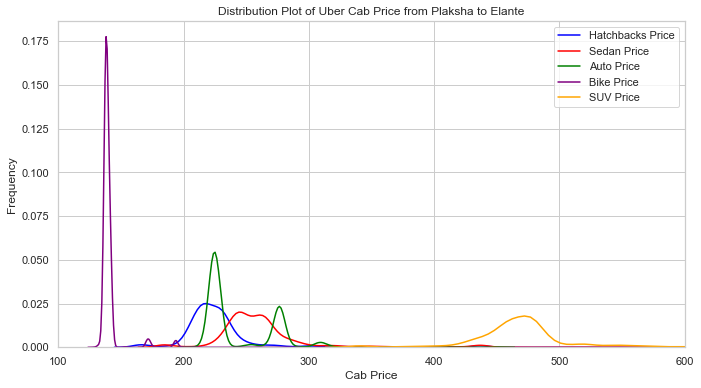

In [63]:
Plaksha_Elante_Hatchbacks_df = Hatchbacks[(Hatchbacks['Pick_Up'] == "Plaksha University") & (Hatchbacks['Destination'] == 'Elante Mall')]
Plaksha_Elante_Sedan_df = Sedan[(Sedan['Pick_Up'] == "Plaksha University") & (Sedan['Destination'] == 'Elante Mall')]
Plaksha_Elante_Auto_df = Auto[(Auto['Pick_Up'] == "Plaksha University") & (Auto['Destination'] == 'Elante Mall')]
Plaksha_Elante_Bike_df = Bike[(Bike['Pick_Up'] == "Plaksha University") & (Bike['Destination'] == 'Elante Mall')]
Plaksha_Elante_SUV_df = SUV[(SUV['Pick_Up'] == "Plaksha University") & (SUV['Destination'] == 'Elante Mall')]

sns.set(style="whitegrid")

plt.figure(figsize=(10, 6))

sns.distplot(Plaksha_Elante_Hatchbacks_df['Cab_Price'], hist=False, bins=20, label='Hatchbacks Price', kde=True, color='blue')
sns.distplot(Plaksha_Elante_Sedan_df['Cab_Price'], hist=False, bins=20, kde=True, label='Sedan Price', color='red')
sns.distplot(Plaksha_Elante_Auto_df['Cab_Price'], hist=False, bins=20, kde=True, label='Auto Price', color='green')
sns.distplot(Plaksha_Elante_Bike_df['Cab_Price'], hist=False, bins=20, kde=True, label='Bike Price', color='purple')
sns.distplot(Plaksha_Elante_SUV_df['Cab_Price'], hist=False, bins=20, kde=True, label='SUV Price', color='orange')

plt.xlabel('Cab Price')
plt.ylabel('Frequency')
plt.title('Distribution Plot of Uber Cab Price from Plaksha to Elante')
plt.xlim(100, 600)

plt.legend()
plt.show()

In [64]:
## Plaksha to Elante df

Plaksha_Elante_df = df[(df['Pick_Up'] == "Plaksha University") & (df['Destination'] == 'Elante Mall')]

In [65]:
cab_type_order = ['Hatchbacks', 'Sedan', 'Auto', 'Bike', 'SUV']

fig = px.box(Plaksha_Elante_df, x='Cab_Type', y='Cab_Price', color='Cab_Type', boxmode='overlay', points='all',
             category_orders={"Cab_Type": cab_type_order},
             title='Plaksha to Elante Cab Price Box Plot')

fig.update_layout(
    xaxis_title='Cab Type',
    yaxis_title='Cab Price',
)

fig.show()

#### (ii) Elante to Plaksha

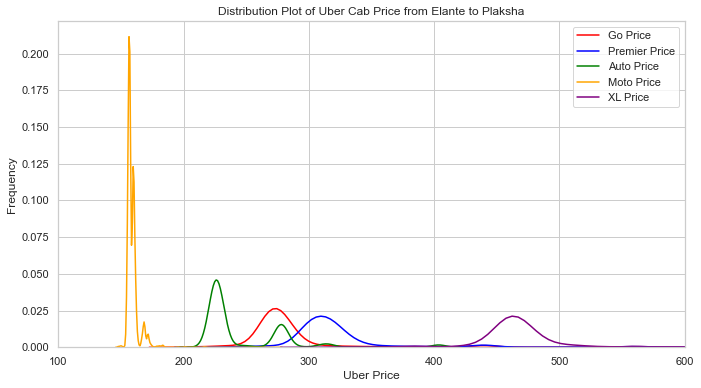

In [66]:
Elante_Plaksha_Hatchbacks_df = Hatchbacks[(Hatchbacks['Pick_Up'] == "Elante Mall") & (Hatchbacks['Destination'] == 'Plaksha University')]
Elante_Plakhsa_Sedan_df = Sedan[(Sedan['Pick_Up'] == "Elante Mall") & (Sedan['Destination'] == 'Plaksha University')]
Elante_Plaksha_Auto_df = Auto[(Auto['Pick_Up'] == "Elante Mall") & (Auto['Destination'] == 'Plaksha University')]
Elante_Plaksha_Bike_df = Bike[(Bike['Pick_Up'] == "Elante Mall") & (Bike['Destination'] == 'Plaksha University')]
Elante_Plaksha_SUV_df = SUV[(SUV['Pick_Up'] == "Elante Mall") & (SUV['Destination'] == 'Plaksha University')]

sns.set(style="whitegrid")

plt.figure(figsize=(10, 6))

sns.distplot(Elante_Plaksha_Hatchbacks_df['Cab_Price'], hist=False, bins=20, label='Go Price', kde=True, color='red')
sns.distplot(Elante_Plakhsa_Sedan_df['Cab_Price'], hist=False, bins=20, kde=True, label='Premier Price', color='blue')
sns.distplot(Elante_Plaksha_Auto_df['Cab_Price'], hist=False, bins=20, kde=True, label='Auto Price', color='green')
sns.distplot(Elante_Plaksha_Bike_df['Cab_Price'], hist=False, bins=20, kde=True, label='Moto Price', color='orange')
sns.distplot(Elante_Plaksha_SUV_df['Cab_Price'], hist=False, bins=20, kde=True, label='XL Price', color='purple')

plt.xlabel('Uber Price')
plt.ylabel('Frequency')
plt.title('Distribution Plot of Uber Cab Price from Elante to Plaksha')
plt.xlim(100, 600)

plt.legend()
plt.show()

In [67]:
Elante_Plaksha_df = df[(df['Pick_Up'] == 'Elante Mall') & (df['Destination'] == 'Plaksha University')]
Elante_Plaksha_df.sample(3)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time
178721,Auto,225.62,Elante Mall,Plaksha University,Wednesday,3 mins away,11:06,20/09/2023,10:34,1,32.0
215766,Bike,157.06,Elante Mall,Plaksha University,Friday,1 min away,13:01,22/09/2023,12:25,1,36.0
105561,Bike,155.78,Elante Mall,Plaksha University,Friday,3 mins away,22:55,15/09/2023,22:27,1,28.0


In [68]:
cab_type_order = ['Hatchbacks', 'Sedan', 'Auto', 'Bike', 'SUV']

fig = px.box(Elante_Plaksha_df, x='Cab_Type', y='Cab_Price', color='Cab_Type', boxmode='overlay', points='all',
             category_orders={"Cab_Type": cab_type_order},
             title='Elante to Plaksha Cab Price Box Plot')

fig.update_layout(
    xaxis_title='Cab Type',
    yaxis_title='Cab Price',
)

fig.show()

#### (iii) Plaksha to Railway Station Chandigarh (Panchkula Side)

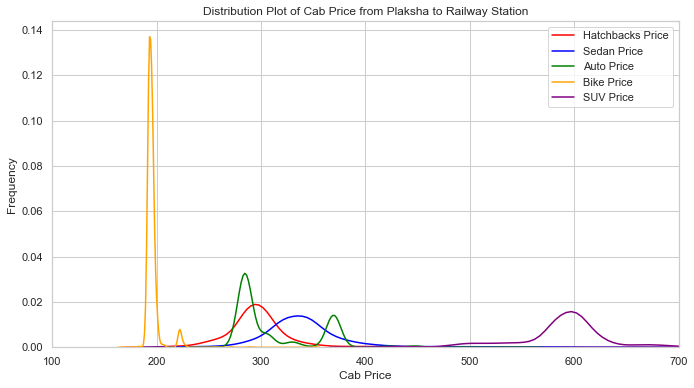

In [69]:
Plaksha_Station_Hatchbacks_df = Hatchbacks[(Hatchbacks['Pick_Up'] == "Plaksha University") & (Hatchbacks['Destination'] == 'Railway Station Chandigarh (Panchkula Side)')]
Plakhsa_Station_Sedan_df = Sedan[(Sedan['Pick_Up'] == "Plaksha University") & (Sedan['Destination'] == 'Railway Station Chandigarh (Panchkula Side)')]
Plaksha_Station_Auto_df = Auto[(Auto['Pick_Up'] == "Plaksha University") & (Auto['Destination'] == 'Railway Station Chandigarh (Panchkula Side)')]
Plaksha_Station_Bike_df = Bike[(Bike['Pick_Up'] == "Plaksha University") & (Bike['Destination'] == 'Railway Station Chandigarh (Panchkula Side)')]
Plaksha_Station_SUV_df = SUV[(SUV['Pick_Up'] == "Plaksha University") & (SUV['Destination'] == 'Railway Station Chandigarh (Panchkula Side)')]

sns.set(style="whitegrid")

plt.figure(figsize=(10, 6))

sns.distplot(Plaksha_Station_Hatchbacks_df['Cab_Price'], hist=False, bins=20, label='Hatchbacks Price', kde=True, color='red')
sns.distplot(Plakhsa_Station_Sedan_df['Cab_Price'], hist=False, bins=20, kde=True, label='Sedan Price', color='blue')
sns.distplot(Plaksha_Station_Auto_df['Cab_Price'], hist=False, bins=20, kde=True, label='Auto Price', color='green')
sns.distplot(Plaksha_Station_Bike_df['Cab_Price'], hist=False, bins=20, kde=True, label='Bike Price', color='orange')
sns.distplot(Plaksha_Station_SUV_df['Cab_Price'], hist=False, bins=20, kde=True, label='SUV Price', color='purple')

plt.xlabel('Cab Price')
plt.ylabel('Frequency')
plt.title('Distribution Plot of Cab Price from Plaksha to Railway Station')
plt.xlim(100, 700)

plt.legend()
plt.show()


In [70]:
Plaksha_Station_df = df[(df['Pick_Up'] == 'Plaksha University') & (df['Destination'] == 'Railway Station Chandigarh (Panchkula Side)')]
Plaksha_Station_df.head(3)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time
240,Hatchbacks,262.42,Plaksha University,Railway Station Chandigarh (Panchkula Side),Saturday,5 mins away,21:50,09/09/2023,21:04,1,46.0
241,SUV,527.15,Plaksha University,Railway Station Chandigarh (Panchkula Side),Saturday,10 mins away,21:53,09/09/2023,21:04,1,49.0
242,Bike,192.82,Plaksha University,Railway Station Chandigarh (Panchkula Side),Saturday,7 mins away,21:50,09/09/2023,21:04,1,46.0


In [71]:
cab_type_order = ['Hatchbacks', 'Sedan', 'Auto', 'Bike', 'SUV']

fig = px.box(Plaksha_Station_df, x='Cab_Type', y='Cab_Price', color='Cab_Type', boxmode='overlay', points='all',
            category_orders={"Cab_Type": cab_type_order},
            title='Plaksha to Railway Station Cab Price Box Plot')

fig.update_layout(
    xaxis_title = 'Cab Type',
    yaxis_title = 'Cab Price',
)

fig.show()

#### (iv) Railway Station Chandigarh (Panchkula Side) to Plaksha

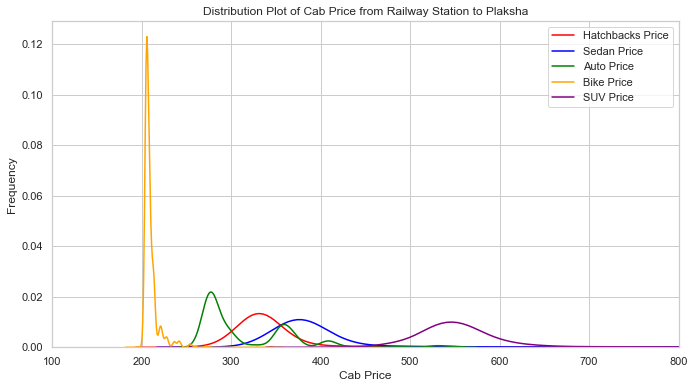

In [72]:
Station_Plaksha_Hatchbacks_df = Hatchbacks[(Hatchbacks['Pick_Up'] == "Railway Station Chandigarh (Panchkula Side)") & (Hatchbacks['Destination'] == 'Plaksha University')]
Station_Plaksha_Sedan_df = Sedan[(Sedan['Pick_Up'] == "Railway Station Chandigarh (Panchkula Side)") & (Sedan['Destination'] == 'Plaksha University')]
Station_Plaksha_Auto_df = Auto[(Auto['Pick_Up'] == "Railway Station Chandigarh (Panchkula Side)") & (Auto['Destination'] == 'Plaksha University')]
Station_Plaksha_Bike_df = Bike[(Bike['Pick_Up'] == "Railway Station Chandigarh (Panchkula Side)") & (Bike['Destination'] == 'Plaksha University')]
Station_Plaksha_SUV_df = SUV[(SUV['Pick_Up'] == "Railway Station Chandigarh (Panchkula Side)") & (SUV['Destination'] == 'Plaksha University')]

sns.set(style="whitegrid")

plt.figure(figsize=(10, 6))

sns.distplot(Station_Plaksha_Hatchbacks_df['Cab_Price'], hist=False, bins=20, label='Hatchbacks Price', kde=True, color='red')
sns.distplot(Station_Plaksha_Sedan_df['Cab_Price'], hist=False, bins=20, kde=True, label='Sedan Price', color='blue')
sns.distplot(Station_Plaksha_Auto_df['Cab_Price'], hist=False, bins=20, kde=True, label='Auto Price', color='green')
sns.distplot(Station_Plaksha_Bike_df['Cab_Price'], hist=False, bins=20, kde=True, label='Bike Price', color='orange')
sns.distplot(Station_Plaksha_SUV_df['Cab_Price'], hist=False, bins=20, kde=True, label='SUV Price', color='purple')

plt.xlabel('Cab Price')
plt.ylabel('Frequency')
plt.title('Distribution Plot of Cab Price from Railway Station to Plaksha')
plt.xlim(100, 800)

plt.legend()
plt.show()


In [73]:
Station_Plaksha_df = df[(df['Pick_Up'] == 'Railway Station Chandigarh (Panchkula Side)') & (df['Destination'] == 'Plaksha University')]
Station_Plaksha_df.sample(3)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time
36617,SUV,533.53,Railway Station Chandigarh (Panchkula Side),Plaksha University,Monday,6 mins away,14:36,11/09/2023,13:44,1,52.0
269834,Auto,356.66,Railway Station Chandigarh (Panchkula Side),Plaksha University,Tuesday,6 mins away,23:24,26/09/2023,22:46,1,38.0
202255,Sedan,358.93,Railway Station Chandigarh (Panchkula Side),Plaksha University,Thursday,7 mins away,22:43,21/09/2023,22:02,1,41.0


In [74]:
cab_type_order = ['Hatchbacks', 'Sedan', 'Auto', 'Bike', 'SUV']

fig = px.box(Station_Plaksha_df, x='Cab_Type', y='Cab_Price', color='Cab_Type', boxmode='overlay', points='all',
            category_orders={"Cab_Type": cab_type_order},
            title='Plaksha to Railway Station Cab Price Box Plot')

fig.update_layout(
    xaxis_title = 'Cab Type',
    yaxis_title = 'Cab Price',
)

fig.show()

#### (v) Plaksha to Mohali Airport

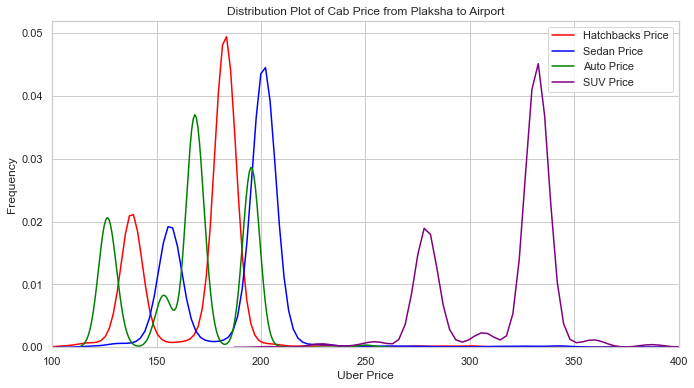

In [75]:
Plaksha_Airport_Hatchbacks_df = Hatchbacks[(Hatchbacks['Pick_Up'] == "Plaksha University") & (Hatchbacks['Destination'] == 'Chandigarh Airport Departure Terminal (IXC)')]
Plaksha_Airport_Sedan_df = Sedan[(Sedan['Pick_Up'] == "Plaksha University") & (Sedan['Destination'] == 'Chandigarh Airport Departure Terminal (IXC)')]
Plaksha_Airport_Auto_df = Auto[(Auto['Pick_Up'] == "Plaksha University") & (Auto['Destination'] == 'Chandigarh Airport Departure Terminal (IXC)')]
Plaksha_Airport_Bike_df = Bike[(Bike['Pick_Up'] == "Plaksha University") & (Bike['Destination'] == 'Chandigarh Airport Departure Terminal (IXC)')]
Plaksha_Airport_SUV_df = SUV[(SUV['Pick_Up'] == "Plaksha University") & (SUV['Destination'] == 'Chandigarh Airport Departure Terminal (IXC)')]

sns.set(style="whitegrid")

plt.figure(figsize=(10, 6))

sns.distplot(Plaksha_Airport_Hatchbacks_df['Cab_Price'], hist=False, bins=20, label='Hatchbacks Price', kde=True, color='red')
sns.distplot(Plaksha_Airport_Sedan_df['Cab_Price'], hist=False, bins=20, kde=True, label='Sedan Price', color='blue')
sns.distplot(Plaksha_Airport_Auto_df['Cab_Price'], hist=False, bins=20, kde=True, label='Auto Price', color='green')
sns.distplot(Plaksha_Airport_Bike_df['Cab_Price'], hist=False, bins=20, kde=True, label='Bike Price', color='orange')
sns.distplot(Plaksha_Airport_SUV_df['Cab_Price'], hist=False, bins=20, kde=True, label='SUV Price', color='purple')

plt.xlabel('Uber Price')
plt.ylabel('Frequency')
plt.title('Distribution Plot of Cab Price from Plaksha to Airport')
plt.xlim(100, 400)

plt.legend()
plt.show()

 

In [76]:
Plaksha_Airport_df = df[(df['Pick_Up'] == 'Plaksha University') & (df['Destination'] == 'Chandigarh Airport Departure Terminal (IXC)')]
Plaksha_Airport_df.sample(3)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time
249841,Auto,195.34,Plaksha University,Chandigarh Airport Departure Terminal (IXC),Monday,Unavailable,0,25/09/2023,00:55,0,NaN
230218,Sedan,200.02,Plaksha University,Chandigarh Airport Departure Terminal (IXC),Saturday,9 mins away,4:11,23/09/2023,03:50,1,21.0
124707,Sedan,201.35,Plaksha University,Chandigarh Airport Departure Terminal (IXC),Saturday,9 mins away,21:06,16/09/2023,20:44,1,22.0


In [77]:
cab_type_order = ['Hatchbacks', 'Sedan', 'Auto', 'Bike', 'SUV']

fig = px.box(Plaksha_Airport_df, x='Cab_Type', y='Cab_Price', color='Cab_Type', boxmode='overlay', points='all',
            category_orders={"Cab_Type": cab_type_order},
            title='Plaksha to Airport Cab Price Box Plot')

fig.update_layout(
    xaxis_title = 'Cab Type',
    yaxis_title = 'Cab Price',
)

fig.show()

#### (vi) Airport to Plaksha

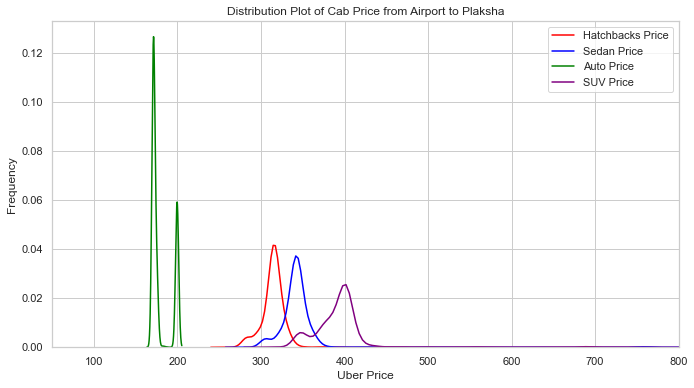

In [78]:
Airport_Plaksha_Hatchbacks_df = Hatchbacks[(Hatchbacks['Pick_Up'] == "Shaheed Bhagat Singh International Airport, Chandigarh") & (Hatchbacks['Destination'] == 'Plaksha University')]
Airport_Plakhsa_Sedan_df = Sedan[(Sedan['Pick_Up'] == "Shaheed Bhagat Singh International Airport, Chandigarh") & (Sedan['Destination'] == 'Plaksha University')]
Airport_Plaksha_Auto_df = Auto[(Auto['Pick_Up'] == "Shaheed Bhagat Singh International Airport, Chandigarh") & (Auto['Destination'] == 'Plaksha University')]
Airport_Plaksha_Bike_df = Bike[(Bike['Pick_Up'] == "Shaheed Bhagat Singh International Airport, Chandigarh") & (Bike['Destination'] == 'Plaksha University')]
Airport_plaksha_SUV_df = SUV[(SUV['Pick_Up'] == "Shaheed Bhagat Singh International Airport, Chandigarh") & (SUV['Destination'] == 'Plaksha University')]

sns.set(style="whitegrid")

plt.figure(figsize=(10, 6))

sns.distplot(Airport_Plaksha_Hatchbacks_df['Cab_Price'], hist=False, bins=20, label='Hatchbacks Price', kde=True, color='red')
sns.distplot(Airport_Plakhsa_Sedan_df['Cab_Price'], hist=False, bins=20, kde=True, label='Sedan Price', color='blue')
sns.distplot(Airport_Plaksha_Auto_df['Cab_Price'], hist=False, bins=20, kde=True, label='Auto Price', color='green')
sns.distplot(Airport_Plaksha_Bike_df['Cab_Price'], hist=False, bins=20, kde=True, label='Bike Price', color='orange')
sns.distplot(Airport_plaksha_SUV_df['Cab_Price'], hist=False, bins=20, kde=True, label='SUV Price', color='purple')

plt.xlim(50, 800)

plt.xlabel('Uber Price')
plt.ylabel('Frequency')
plt.title('Distribution Plot of Cab Price from Airport to Plaksha')


plt.legend()
plt.show()

In [79]:
Airport_Plaksha_df = df[(df['Pick_Up'] == 'Shaheed Bhagat Singh International Airport, Chandigarh') & (df['Destination'] == 'Plaksha University')]
Airport_Plaksha_df.sample(3)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time
328123,Auto,171.25,"Shaheed Bhagat Singh International Airport, Ch...",Plaksha University,Monday,3 mins away,15:31,02/10/2023,15:15,1,16.0
330914,Auto,175.25,"Shaheed Bhagat Singh International Airport, Ch...",Plaksha University,Tuesday,Unavailable,0,03/10/2023,20:07,0,NaN
98268,SUV,402.02,"Shaheed Bhagat Singh International Airport, Ch...",Plaksha University,Friday,2 mins away,11:27,15/09/2023,11:11,1,16.0


In [80]:
cab_type_order = ['Hatchbacks', 'Sedan', 'Auto', 'Bike', 'SUV']

fig = px.box(Airport_Plaksha_df, x='Cab_Type', y='Cab_Price', color='Cab_Type', boxmode='overlay', points='all',
            category_orders={"Cab_Type": cab_type_order},
            title='Airport to Plaksha Cab Price Box Plot')

fig.update_layout(
    xaxis_title = 'Cab Type',
    yaxis_title = 'Cab Price',
)

fig.show()

#### (vii) Plaksha to Sector 82

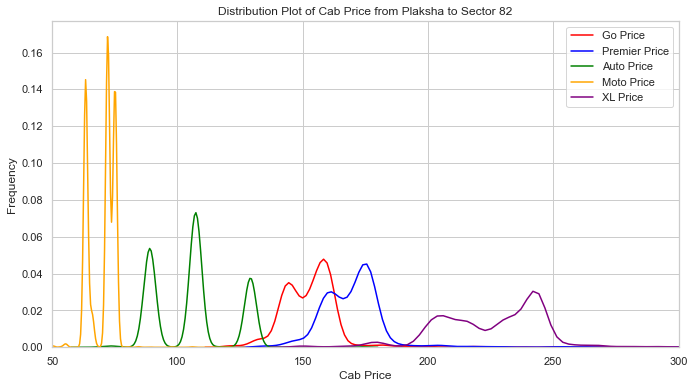

In [81]:
Plaksha_Sector82_Hatchbacks_df = Hatchbacks[(Hatchbacks['Pick_Up'] == "Plaksha University") & (Hatchbacks['Destination'] == 'Sector 82')]
Plaksha_Sector82_Sedan_df = Sedan[(Sedan['Pick_Up'] == "Plaksha University") & (Sedan['Destination'] == 'Sector 82')]
Plaksha_Sector82_Auto_df = Auto[(Auto['Pick_Up'] == "Plaksha University") & (Auto['Destination'] == 'Sector 82')]
Plaksha_Sector82_Bike_df = Bike[(Bike['Pick_Up'] == "Plaksha University") & (Bike['Destination'] == 'Sector 82')]
Plaksha_Sector82_SUV_df = SUV[(SUV['Pick_Up'] == "Plaksha University") & (SUV['Destination'] == 'Sector 82')]

sns.set(style="whitegrid")

plt.figure(figsize=(10, 6))

sns.distplot(Plaksha_Sector82_Hatchbacks_df['Cab_Price'], hist=False, bins=20, label='Go Price', kde=True, color='red')
sns.distplot(Plaksha_Sector82_Sedan_df['Cab_Price'], hist=False, bins=20, kde=True, label='Premier Price', color='blue')
sns.distplot(Plaksha_Sector82_Auto_df['Cab_Price'], hist=False, bins=20, kde=True, label='Auto Price', color='green')
sns.distplot(Plaksha_Sector82_Bike_df['Cab_Price'], hist=False, bins=20, kde=True, label='Moto Price', color='orange')
sns.distplot(Plaksha_Sector82_SUV_df['Cab_Price'], hist=False, bins=20, kde=True, label='XL Price', color='purple')

plt.xlim(50, 300)

plt.xlabel('Cab Price')
plt.ylabel('Frequency')
plt.title('Distribution Plot of Cab Price from Plaksha to Sector 82')


plt.legend()
plt.show()


In [82]:
Plaksha_Sector82_df = df[(df['Pick_Up'] == 'Plaksha University') & (df['Destination'] == 'Sector 82')]
Plaksha_Sector82_df.sample(3)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time
224596,Auto,107.31,Plaksha University,Sector 82,Friday,Unavailable,0,22/09/2023,21:20,0,NaN
79189,SUV,167.26,Plaksha University,Sector 82,Thursday,10 mins away,1:45,14/09/2023,01:26,1,19.0
329769,Bike,75.09,Plaksha University,Sector 82,Monday,6 mins away,20:29,02/10/2023,20:13,1,16.0


In [83]:
cab_type_order = ['Hatchbacks', 'Sedan', 'Auto', 'Bike', 'SUV']

fig = px.box(Plaksha_Sector82_df, x='Cab_Type', y='Cab_Price', color='Cab_Type', boxmode='overlay', points='all',
            category_orders={"Cab_Type": cab_type_order},
            title='Plaksha to Sector 82 Cab Price Box Plot')

fig.update_layout(
    xaxis_title = 'Cab Type',
    yaxis_title = 'Cab Price',
)

fig.show()

# Plotting the Cab Prices Variation throughout a Particular Day for all Routes

### (i) Plaksha to Elante Mall Uber Go Price

#### (a) For the Entire Data of Plaksha to Elante

In [84]:
hour_minute = Plaksha_Elante_df['Current_Time'].str.split(':')

Plaksha_Elante_df['Hour'] = hour_minute.str[0].astype(int)

Plaksha_Elante_df.sample(3)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time,Hour
177900,SUV,478.85,Plaksha University,Elante Mall,Wednesday,9 mins away,10:17,20/09/2023,09:31,1,46.0,9
241436,SUV,487.60,Plaksha University,Elante Mall,Saturday,9 mins away,19:09,23/09/2023,18:17,1,52.0,18
4959,Auto,276.45,Plaksha University,Elante Mall,Sunday,Unavailable,0,10/09/2023,2:20,0,NaN,2


In [85]:
hourly_price_summary = Plaksha_Elante_df.groupby(['Hour'])['Cab_Price'].mean().reset_index()
hourly_price_summary.sample(3)

,Hour,Cab_Price
15,15,274.485165
9,9,267.362402
14,14,291.163947


In [86]:
fig = px.line(hourly_price_summary, x='Hour', y='Cab_Price', labels={'Hour': 'Hour of the Day', 'Cab_Price': 'Average Cab Price'},              title='Plaksha to Elante Hourly Cab Price',
              markers=True)

fig.update_xaxes(dtick=1)
fig.show()

#### (b) Over the Entire week

In [87]:
hour_minute = Plaksha_Elante_df['Current_Time'].str.split(':')

Plaksha_Elante_df['Hour'] = hour_minute.str[0].astype(int)

Plaksha_Elante_df.sample(3)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time,Hour
220830,SUV,594.00,Plaksha University,Elante Mall,Friday,7 mins away,18:07,22/09/2023,17:21,1,46.0,17
1752,Auto,276.45,Plaksha University,Elante Mall,Saturday,Unavailable,0,09/09/2023,22:49,0,NaN,22
164744,SUV,448.43,Plaksha University,Elante Mall,Tuesday,9 mins away,17:36,19/09/2023,16:54,1,42.0,16


In [88]:
hourly_price_summary = Plaksha_Elante_df.groupby(['Current Day', 'Hour'])['Cab_Price'].mean().reset_index()
hourly_price_summary.sample(3)

,Current Day,Hour,Cab_Price
46,Monday,22,262.574195
5,Friday,5,256.821048
133,Tuesday,19,272.741587


In [89]:
Days_groups = hourly_price_summary.groupby('Current Day')

fig = go.Figure()

max_value = float('-inf')
min_value = float('inf')
max_x = None
min_x = None


for day, data in Days_groups:
    fig.add_trace(go.Scatter(x=data['Hour'], y=data['Cab_Price'], mode='lines', name=day))
    
    max_day_value = data['Cab_Price'].max()
    min_day_value = data['Cab_Price'].min()
    
    if max_day_value > max_value:
        max_value = max_day_value
        max_x = data[data['Cab_Price'] == max_value]['Hour'].values[0]
    
    if min_day_value < min_value:
        min_value = min_day_value
        min_x = data[data['Cab_Price'] == min_value]['Hour'].values[0]


fig.add_annotation(
    text=f'Max: {max_value}',
    x=max_x,
    y=max_value,
    showarrow=True,
    arrowhead=2,
    arrowcolor='red',
)

fig.add_annotation(
    text=f'Min: {min_value}',
    x=min_x,
    y=min_value,
    showarrow=True,
    arrowhead=2,
    arrowcolor='blue',
)

fig.update_layout(
    title='Plaksha to Elante Cab Price',
    xaxis_title='Hour of the Day',
    yaxis_title='Average Cab Price',
    legend_title='Day of the Week',
)

fig.update_xaxes(dtick=1)
fig.show()


# Plotting the Cab Prices Variation throughout the Day based on Cab Types

### (i) Plaksha to Elante

In [90]:
hour_minute = Plaksha_Elante_df['Current_Time'].str.split(':')

Plaksha_Elante_df['Hour'] = hour_minute.str[0].astype(int)

Plaksha_Elante_df.sample(3)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time,Hour
139158,Bike,141.80,Plaksha University,Elante Mall,Sunday,7 mins away,0:13,17/09/2023,23:41,1,-1408.0,23
230955,Sedan,240.91,Plaksha University,Elante Mall,Saturday,Unavailable,0,23/09/2023,05:28,0,NaN,5
194715,Hatchbacks,231.10,Plaksha University,Elante Mall,Thursday,4 mins away,15:01,21/09/2023,14:24,1,37.0,14


In [91]:
hourly_price_summary = Plaksha_Elante_df.groupby(['Cab_Type', 'Hour'])['Cab_Price'].mean().reset_index()
hourly_price_summary.tail(3)

,Cab_Type,Hour,Cab_Price
117,Sedan,21,242.199859
118,Sedan,22,242.055642
119,Sedan,23,236.530964


In [92]:
Cab_groups = hourly_price_summary.groupby('Cab_Type')

fig = go.Figure()

max_value = float('-inf')
min_value = float('inf')
max_x = None
min_x = None


for cab, data in Cab_groups:
    fig.add_trace(go.Scatter(x=data['Hour'], y=data['Cab_Price'], mode='lines', name=cab))
    
    max_day_value = data['Cab_Price'].max()
    min_day_value = data['Cab_Price'].min()
    
    if max_day_value > max_value:
        max_value = max_day_value
        max_x = data[data['Cab_Price'] == max_value]['Hour'].values[0]
    
    if min_day_value < min_value:
        min_value = min_day_value
        min_x = data[data['Cab_Price'] == min_value]['Hour'].values[0]


max_value = round(max_value, 2)
min_value = round(min_value, 2)

fig.add_annotation(
    text=f'Max: {max_value}',
    x=max_x,
    y=max_value,
    showarrow=True,
    arrowhead=2,
    arrowcolor='red',
)

fig.add_annotation(
    text=f'Min: {min_value}',
    x=min_x,
    y=min_value,
    showarrow=True,
    arrowhead=2,
    arrowcolor='blue',
)

fig.update_layout(
    title='Plaksha to Elante Cab Price for each Cab Type',
    xaxis_title='Hour of the Day',
    yaxis_title='Average Cab Price',
    legend_title='Cab Type',
)

fig.update_xaxes(dtick=1)
fig.show()


### (ii) Elante to Plaksha

In [93]:
hour_minute = Elante_Plaksha_df['Current_Time'].str.split(':')

Elante_Plaksha_df['Hour'] = hour_minute.str[0].astype(int)

Elante_Plaksha_df.sample(3)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time,Hour
184719,Bike,157.61,Elante Mall,Plaksha University,Wednesday,1 min away,17:25,20/09/2023,16:49,1,36.0,16
193157,Sedan,310.03,Elante Mall,Plaksha University,Thursday,4 mins away,13:33,21/09/2023,12:56,1,37.0,12
169374,SUV,461.07,Elante Mall,Plaksha University,Tuesday,5 mins away,23:02,19/09/2023,22:31,1,31.0,22


In [94]:
hourly_price_summary = Elante_Plaksha_df.groupby(['Cab_Type', 'Hour'])['Cab_Price'].mean().reset_index()
hourly_price_summary.tail(3)

,Cab_Type,Hour,Cab_Price
117,Sedan,21,329.228407
118,Sedan,22,333.160052
119,Sedan,23,322.377054


In [95]:
Cab_groups = hourly_price_summary.groupby('Cab_Type')

fig = go.Figure()

max_value = float('-inf')
min_value = float('inf')
max_x = None
min_x = None


for cab, data in Cab_groups:
    fig.add_trace(go.Scatter(x=data['Hour'], y=data['Cab_Price'], mode='lines', name=cab))
    
    max_day_value = data['Cab_Price'].max()
    min_day_value = data['Cab_Price'].min()
    
    if max_day_value > max_value:
        max_value = max_day_value
        max_x = data[data['Cab_Price'] == max_value]['Hour'].values[0]
    
    if min_day_value < min_value:
        min_value = min_day_value
        min_x = data[data['Cab_Price'] == min_value]['Hour'].values[0]


max_value = round(max_value, 2)
min_value = round(min_value, 2)

fig.add_annotation(
    text=f'Max: {max_value}',
    x=max_x,
    y=max_value,
    showarrow=True,
    arrowhead=2,
    arrowcolor='red',
)

fig.add_annotation(
    text=f'Min: {min_value}',
    x=min_x,
    y=min_value,
    showarrow=True,
    arrowhead=2,
    arrowcolor='blue',
)

fig.update_layout(
    title='Elante to Plaksha Cab Price for each Cab Type',
    xaxis_title='Hour of the Day',
    yaxis_title='Average Cab Price',
    legend_title='Day of the Week',
)

fig.update_xaxes(dtick=1)
fig.show()

### (iii) Plaksha to Railway Station

In [96]:
hour_minute = Plaksha_Station_df['Current_Time'].str.split(':')

Plaksha_Station_df['Hour'] = hour_minute.str[0].astype(int)

Plaksha_Station_df.sample(3)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time,Hour
143787,Bike,192.89,Plaksha University,Railway Station Chandigarh (Panchkula Side),Monday,8 mins away,13:45,18/09/2023,13:02,1,43.0,13
220169,Hatchbacks,227.50,Plaksha University,Railway Station Chandigarh (Panchkula Side),Friday,5 mins away,17:29,22/09/2023,16:43,1,46.0,16
198806,Bike,194.95,Plaksha University,Railway Station Chandigarh (Panchkula Side),Thursday,7 mins away,19:14,21/09/2023,18:21,1,53.0,18


In [97]:
hourly_price_summary = Plaksha_Station_df.groupby(['Cab_Type', 'Hour'])['Cab_Price'].mean().reset_index()
hourly_price_summary.tail(3)

,Cab_Type,Hour,Cab_Price
117,Sedan,21,319.966326
118,Sedan,22,317.919840
119,Sedan,23,325.767683


In [98]:
Cab_groups = hourly_price_summary.groupby('Cab_Type')

fig = go.Figure()

max_value = float('-inf')
min_value = float('inf')
max_x = None
min_x = None


for cab, data in Cab_groups:
    fig.add_trace(go.Scatter(x=data['Hour'], y=data['Cab_Price'], mode='lines', name=cab))
    
    max_day_value = data['Cab_Price'].max()
    min_day_value = data['Cab_Price'].min()
    
    if max_day_value > max_value:
        max_value = max_day_value
        max_x = data[data['Cab_Price'] == max_value]['Hour'].values[0]
    
    if min_day_value < min_value:
        min_value = min_day_value
        min_x = data[data['Cab_Price'] == min_value]['Hour'].values[0]


max_value = round(max_value, 2)
min_value = round(min_value, 2)

fig.add_annotation(
    text=f'Max: {max_value}',
    x=max_x,
    y=max_value,
    showarrow=True,
    arrowhead=2,
    arrowcolor='red',
)

fig.add_annotation(
    text=f'Min: {min_value}',
    x=min_x,
    y=min_value,
    showarrow=True,
    arrowhead=2,
    arrowcolor='blue',
)

fig.update_layout(
    title='Plaksha to Chandigarh Railway Station Cab Price for each Cab Type',
    xaxis_title='Hour of the Day',
    yaxis_title='Average Cab Price',
    legend_title='Day of the Week',
)

fig.update_xaxes(dtick=1)
fig.show()

### (iv) Station to Plaksha

In [99]:
hour_minute = Station_Plaksha_df['Current_Time'].str.split(':')

Station_Plaksha_df['Hour'] = hour_minute.str[0].astype(int)

Station_Plaksha_df.sample(3)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time,Hour
48351,SUV,518.72,Railway Station Chandigarh (Panchkula Side),Plaksha University,Tuesday,9 mins away,4:25,12/09/2023,3:48,1,37.0,3
61647,Sedan,350.20,Railway Station Chandigarh (Panchkula Side),Plaksha University,Wednesday,4 mins away,1:34,13/09/2023,01:01,1,33.0,1
190638,Auto,276.26,Railway Station Chandigarh (Panchkula Side),Plaksha University,Thursday,1 min away,10:55,21/09/2023,10:13,1,42.0,10


In [100]:
hourly_price_summary = Station_Plaksha_df.groupby(['Cab_Type', 'Hour'])['Cab_Price'].mean().reset_index()
hourly_price_summary.tail(3)

,Cab_Type,Hour,Cab_Price
117,Sedan,21,376.467705
118,Sedan,22,396.281281
119,Sedan,23,394.750029


In [101]:
Cab_groups = hourly_price_summary.groupby('Cab_Type')

fig = go.Figure()

max_value = float('-inf')
min_value = float('inf')
max_x = None
min_x = None


for cab, data in Cab_groups:
    fig.add_trace(go.Scatter(x=data['Hour'], y=data['Cab_Price'], mode='lines', name=cab))
    
    max_day_value = data['Cab_Price'].max()
    min_day_value = data['Cab_Price'].min()
    
    if max_day_value > max_value:
        max_value = max_day_value
        max_x = data[data['Cab_Price'] == max_value]['Hour'].values[0]
    
    if min_day_value < min_value:
        min_value = min_day_value
        min_x = data[data['Cab_Price'] == min_value]['Hour'].values[0]


max_value = round(max_value, 2)
min_value = round(min_value, 2)

fig.add_annotation(
    text=f'Max: {max_value}',
    x=max_x,
    y=max_value,
    showarrow=True,
    arrowhead=2,
    arrowcolor='red',
)

fig.add_annotation(
    text=f'Min: {min_value}',
    x=min_x,
    y=min_value,
    showarrow=True,
    arrowhead=2,
    arrowcolor='blue',
)

fig.update_layout(
    title='Chandigarh Railway Station to Plkasha Cab Price for each Cab Type',
    xaxis_title='Hour of the Day',
    yaxis_title='Average Cab Price',
    legend_title='Day of the Week',
)

fig.update_xaxes(dtick=1)
fig.show()

### (v) Plaksha to Airport

In [102]:
hour_minute = Plaksha_Airport_df['Current_Time'].str.split(':')

Plaksha_Airport_df['Hour'] = hour_minute.str[0].astype(int)

Plaksha_Airport_df.sample(3)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time,Hour
109107,SUV,308.64,Plaksha University,Chandigarh Airport Departure Terminal (IXC),Saturday,11 mins away,3:20,16/09/2023,02:57,1,23.0,2
324074,Hatchbacks,138.66,Plaksha University,Chandigarh Airport Departure Terminal (IXC),Monday,6 mins away,10:27,02/10/2023,10:09,1,18.0,10
318584,Auto,125.87,Plaksha University,Chandigarh Airport Departure Terminal (IXC),Sunday,5 mins away,10:39,01/10/2023,10:21,1,18.0,10


In [103]:
hourly_price_summary = Plaksha_Airport_df.groupby(['Cab_Type', 'Hour'])['Cab_Price'].mean().reset_index()
hourly_price_summary.tail(3)

,Cab_Type,Hour,Cab_Price
93,Sedan,21,186.252136
94,Sedan,22,187.634202
95,Sedan,23,191.323185


In [104]:
Cab_groups = hourly_price_summary.groupby('Cab_Type')

fig = go.Figure()

max_value = float('-inf')
min_value = float('inf')
max_x = None
min_x = None


for cab, data in Cab_groups:
    fig.add_trace(go.Scatter(x=data['Hour'], y=data['Cab_Price'], mode='lines', name=cab))
    
    max_day_value = data['Cab_Price'].max()
    min_day_value = data['Cab_Price'].min()
    
    if max_day_value > max_value:
        max_value = max_day_value
        max_x = data[data['Cab_Price'] == max_value]['Hour'].values[0]
    
    if min_day_value < min_value:
        min_value = min_day_value
        min_x = data[data['Cab_Price'] == min_value]['Hour'].values[0]


max_value = round(max_value, 2)
min_value = round(min_value, 2)

fig.add_annotation(
    text=f'Max: {max_value}',
    x=max_x,
    y=max_value,
    showarrow=True,
    arrowhead=2,
    arrowcolor='red',
)

fig.add_annotation(
    text=f'Min: {min_value}',
    x=min_x,
    y=min_value,
    showarrow=True,
    arrowhead=2,
    arrowcolor='blue',
)

fig.update_layout(
    title='Plaksha to Airport Cab Price for each Cab Type',
    xaxis_title='Hour of the Day',
    yaxis_title='Average Cab Price',
    legend_title='Day of the Week',
)

fig.update_xaxes(dtick=1)
fig.show()

## Machine Learning Models

In [105]:
df.sample(6)

,Cab_Type,Cab_Price,Pick_Up,Destination,Current Day,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time
135816,Auto,254.75,Plaksha University,Elante Mall,Sunday,Unavailable,0,17/09/2023,15:54,0,NaN
167647,SUV,244.81,Plaksha University,Sector 82,Tuesday,10 mins away,20:48,19/09/2023,20:26,1,22.0
130391,Auto,224.36,Plaksha University,Elante Mall,Sunday,Unavailable,0,17/09/2023,10:35,0,NaN
361393,Auto,199.56,"Shaheed Bhagat Singh International Airport, Ch...",Plaksha University,Friday,5 mins away,3:18,06/10/2023,2:59,1,19.0
41872,Sedan,313.78,Elante Mall,Plaksha University,Monday,3 mins away,21:08,11/09/2023,20:34,1,34.0
247032,Hatchbacks,141.88,Plaksha University,Sector 82,Sunday,8 mins away,19:47,24/09/2023,19:25,1,22.0


In [106]:
df_encoded = pd.get_dummies(df, columns=['Cab_Type'], prefix=['Cab_Type'])
df_encoded = pd.get_dummies(df_encoded, columns=['Current Day'], prefix=['Day'])
df_encoded = pd.get_dummies(df_encoded, columns=['Pick_Up'], prefix=['Pick_Up'])
df_encoded = pd.get_dummies(df_encoded, columns=['Destination'], prefix=['Destination'])

In [107]:
df_encoded.sample(5)

,Cab_Price,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time,Cab_Type_Auto,Cab_Type_Bike,Cab_Type_Hatchbacks,...,Pick_Up_Elante Mall,Pick_Up_Plaksha University,Pick_Up_Railway Station Chandigarh (Panchkula Side),Pick_Up_Sector 82,"Pick_Up_Shaheed Bhagat Singh International Airport, Chandigarh",Destination_Chandigarh Airport Departure Terminal (IXC),Destination_Elante Mall,Destination_Plaksha University,Destination_Railway Station Chandigarh (Panchkula Side),Destination_Sector 82
312634,450.55,8 mins away,20:55,30/09/2023,20:09,1,46.0,0,0,0,...,0,0,0,0,1,0,1,0,0,0
280581,283.90,6 mins away,22:52,27/09/2023,22:38,1,14.0,0,0,0,...,0,0,0,1,0,0,0,1,0,0
42646,428.27,7 mins away,22:03,11/09/2023,21:25,1,38.0,0,0,0,...,0,1,0,0,0,0,1,0,0,0
185608,563.30,8 mins away,18:30,20/09/2023,17:41,1,49.0,0,0,0,...,0,0,1,0,0,0,0,1,0,0
123503,308.41,4 mins away,19:48,16/09/2023,19:28,1,20.0,0,0,1,...,0,0,0,0,1,0,0,1,0,0


In [108]:
df_encoded[['Current_Hour', 'Current_Minute']] = df_encoded['Current_Time'].str.split(':', expand=True)

# Getting duplicate values try to solve the problem.

In [109]:
df_encoded.sample(5)

,Cab_Price,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time,Cab_Type_Auto,Cab_Type_Bike,Cab_Type_Hatchbacks,...,Pick_Up_Railway Station Chandigarh (Panchkula Side),Pick_Up_Sector 82,"Pick_Up_Shaheed Bhagat Singh International Airport, Chandigarh",Destination_Chandigarh Airport Departure Terminal (IXC),Destination_Elante Mall,Destination_Plaksha University,Destination_Railway Station Chandigarh (Panchkula Side),Destination_Sector 82,Current_Hour,Current_Minute
132408,265.27,6 mins away,13:11,17/09/2023,12:32,1,39.0,0,0,0,...,0,0,0,0,1,0,0,0,12,32
220331,206.53,9 mins away,17:14,22/09/2023,16:52,1,22.0,0,0,0,...,0,0,0,0,0,0,0,1,16,52
44069,190.51,7 mins away,23:27,11/09/2023,23:11,1,16.0,0,0,0,...,0,1,0,0,0,1,0,0,23,11
105327,332.08,9 mins away,22:34,15/09/2023,22:11,1,23.0,0,0,0,...,0,0,0,1,0,0,0,0,22,11
150935,323.57,9 mins away,23:13,18/09/2023,22:35,1,38.0,0,0,0,...,0,0,0,0,0,0,1,0,22,35


In [110]:
df_encoded[['Current_Date', 'Current_Month', 'Current_Year']] = df_encoded['Current_Date'].str.split('/', expand=True)

In [111]:
df_encoded.sample(5)

,Cab_Price,Cab_Arrival_Time,Cab_Destination_Time,Current_Date,Current_Time,Availability,Route_Time,Cab_Type_Auto,Cab_Type_Bike,Cab_Type_Hatchbacks,...,"Pick_Up_Shaheed Bhagat Singh International Airport, Chandigarh",Destination_Chandigarh Airport Departure Terminal (IXC),Destination_Elante Mall,Destination_Plaksha University,Destination_Railway Station Chandigarh (Panchkula Side),Destination_Sector 82,Current_Hour,Current_Minute,Current_Month,Current_Year
28368,316.89,4 mins away,5:12,11,4:55,1,17.0,0,0,1,...,1,0,0,1,0,0,4,55,09,2023
175691,461.10,6 mins away,6:52,20,06:20,1,32.0,0,0,0,...,0,0,1,0,0,0,06,20,09,2023
247091,284.49,Unavailable,0,24,19:28,0,NaN,1,0,0,...,0,0,0,0,1,0,19,28,09,2023
279829,63.36,3 mins away,21:48,27,21:32,1,16.0,0,1,0,...,0,0,0,0,0,1,21,32,09,2023
357977,302.12,6 mins away,22:24,05,21:53,1,31.0,0,0,0,...,0,0,0,1,0,0,21,53,10,2023


## Training a Models for Price Prediction

In [112]:
df_encoded['Current_Date'] = pd.to_numeric(df_encoded['Current_Date'], errors='coerce')
df_encoded['Current_Date'] = df_encoded['Current_Date'].astype(float)

df_encoded['Current_Hour'] = pd.to_numeric(df_encoded['Current_Hour'], errors='coerce')
df_encoded['Current_Hour'] = df_encoded['Current_Hour'].astype(float)

df_encoded['Current_Minute'] = pd.to_numeric(df_encoded['Current_Minute'], errors='coerce')
df_encoded['Current_Minute'] = df_encoded['Current_Minute'].astype(float)

df_encoded['Current_Month'] = pd.to_numeric(df_encoded['Current_Month'], errors='coerce')
df_encoded['Current_Month'] = df_encoded['Current_Month'].astype(float)

df_encoded['Current_Year'] = pd.to_numeric(df_encoded['Current_Year'], errors='coerce')
df_encoded['Current_Year'] = df_encoded['Current_Year'].astype(float)

df_encoded.dtypes

Cab_Price                                                         float64
Cab_Arrival_Time                                                   object
Cab_Destination_Time                                               object
Current_Date                                                      float64
Current_Time                                                       object
Availability                                                        int64
Route_Time                                                        float64
Cab_Type_Auto                                                       uint8
Cab_Type_Bike                                                       uint8
Cab_Type_Hatchbacks                                                 uint8
Cab_Type_SUV                                                        uint8
Cab_Type_Sedan                                                      uint8
Day_Friday                                                          uint8
Day_Monday                            

### 1. Linear Regression Model

In [116]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

X_train, X_test, y_train, y_test = train_test_split(df_encoded.drop(columns=['Cab_Price', 'Cab_Arrival_Time', 'Cab_Destination_Time', 'Current_Date',
                                                                    'Current_Time', 'Availability', 'Route_Time']), df_encoded['Cab_Price'], test_size=0.2,
                                                            random_state=42)

In [117]:
from sklearn.linear_model import LinearRegression

reg = LinearRegression()

reg.fit(X_train, y_train)

LinearRegression()

In [118]:
y_pred = reg.predict(X_test)

mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

In [119]:
print("Mean Squared Error:", mse)
print("R-squared:", r2)

Mean Squared Error: 3893.352396879444
R-squared: 0.7826919090105554


### 2. Random Forest Regressor Model

In [120]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

In [121]:
random_forest = RandomForestRegressor(n_estimators=100, random_state=42)

In [122]:
random_forest.fit(X_train, y_train)

RandomForestRegressor(random_state=42)

In [123]:
y_pred = random_forest.predict(X_test)

mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("Mean Squared Error:", mse)
print("R-squared:", r2)

Mean Squared Error: 623.3699373086761
R-squared: 0.9652065065660809


### 3. KNN Model

In [124]:
from sklearn.neighbors import KNeighborsRegressor

In [125]:
k_neighbors = 5
knn_regressor = KNeighborsRegressor(n_neighbors=k_neighbors)

In [126]:
knn_regressor.fit(X_train, y_train)

KNeighborsRegressor()

In [127]:
y_pred = knn_regressor.predict(X_test)

In [128]:
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

In [129]:
print("Mean Squared Error:", mse)
print("R-squared:", r2)

Mean Squared Error: 1967.8501889246268
R-squared: 0.8901641248166547


### Cross-Validation Score

In [130]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score

kfold = KFold(n_splits=10, shuffle=True, random_state=22)

xyz = []
mse_scores = []
std = []

classifiers = ['Linear Regression', 'Random Forest', 'KNN']
models = [LinearRegression(), RandomForestRegressor(n_estimators=100, random_state=42), KNeighborsRegressor(n_neighbors=5)]

for i in models:
    model = i
    cv_result = cross_val_score(model, X_train, y_train, cv=kfold, scoring="neg_mean_squared_error")
    mse_scores.append(-cv_result)  # Negate the result to get positive MSE values
    xyz.append(-cv_result.mean())  # Negate to get positive MSE values
    std.append(cv_result.std())

new_models_dataframe2 = pd.DataFrame({'CV Mean': xyz, 'Std': std}, index=classifiers)
new_models_dataframe2

,CV Mean,Std
Linear Regression,3797.761860,162.486438
Random Forest,648.215741,33.210539
KNN,2166.064514,42.084455


In [131]:
box_df = pd.DataFrame({'MSE': [item for sublist in mse_scores for item in sublist],
                       'Classifier': [cls for cls in classifiers for _ in range(10)]})

fig = px.box(box_df, x='Classifier', y='MSE', title='MSE Box Plot', labels={'MSE': 'Mean Squared Error'})

fig.update_traces(marker_color='#FC0080')

fig.update_layout(xaxis_title='Classifier', yaxis_title='MSE')

# Show the plot
fig.show()

In [132]:
fig = px.bar(new_models_dataframe2, x='CV Mean', y=new_models_dataframe2.index, orientation='h')
fig.update_layout(title='Average CV Mean Accuracy')
fig.update_xaxes(title='CV Mean')
fig.update_yaxes(title=None)
fig.update_traces(marker_color='#FC0080')
fig.show()